# Library

In [29]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt

#Plotly
import plotly.graph_objects as go
import plotly

# Seaborn
import plotly.express as px
import seaborn as sb
sb.set(color_codes=True)

In [30]:
import os
os.getcwd()

'C:\\Users\\maxdo\\OneDrive\\Documents\\INSA\\5A\\DefiIA\\notebook'

# Data

In [31]:
DATA_PATH = "C:/Users/maxdo/OneDrive/Documents/INSA/5A/TestIA"

train_df = pd.read_json(DATA_PATH+"/train.json")
#train_df.set_index('Id', inplace=True) 

test_df = pd.read_json(DATA_PATH+"/test.json")
#test_df.set_index('Id', inplace=True) 


train_label = pd.read_csv(DATA_PATH+"/train_label.csv")
#train_label.set_index('Id', inplace=True)

categ = pd.read_csv(DATA_PATH+'/categories_string.csv')

template_submissions = pd.read_csv(DATA_PATH + "/template_submissions.csv")

In [32]:
train_df.head(3)

,Id,description,gender
0,0,She is also a Ronald D. Asmus Policy Entrepre...,F
1,1,He is a member of the AICPA and WICPA. Brent ...,M
2,2,Dr. Aster has held teaching and research posi...,M


In [33]:
test_df.head(3)

,Id,description,gender
3,0,She currently works on CNN’s newest primetime...,F
6,1,Lavalette’s photographs have been shown widel...,M
11,2,Along with his academic and professional deve...,M


In [34]:
train_label.head(3)

,Id,Category
0,0,19
1,1,9
2,2,19


In [35]:
categ.rename(columns={'0':'Category name','1':'Category'}, inplace=True)
categ.head(3)

,Category name,Category
0,pastor,0
1,model,1
2,yoga_teacher,2


In [36]:
template_submissions.head(3)

,Id,Category
0,0,0
1,1,0
2,2,0


In [37]:
train_tot=pd.merge(train_df, train_label)
train_tot=pd.merge(train_tot, categ)

In [38]:
train_tot.head(5)

,Id,description,gender,Category,Category name
0,0,She is also a Ronald D. Asmus Policy Entrepre...,F,19,professor
1,2,Dr. Aster has held teaching and research posi...,M,19,professor
2,10,"An elder in the United Methodist Church, she ...",F,19,professor
3,11,She has written numerous scholarly articles o...,F,19,professor
4,12,"He is an expert on black Pentecostalism, an o...",M,19,professor


# Analyse du jeu de données d'entrainement

In [39]:
print("Number of jobs in the dataset : %d" %(len(train_tot.Category.unique())))
print("Number of people in the dataset : %d" %(len(train_tot.Id.unique())))

Number of jobs in the dataset : 28
Number of people in the dataset : 217197


### Nombre de personnes par métier

In [40]:
fig = px.histogram(train_tot, x="Category name", color="gender")
fig.show()

### Nombre de personnes par métier sous représenté

In [41]:
train_gb_category=train_tot.groupby('Category')

In [42]:
categ_kept=categ[(train_gb_category.count()['Id']<10000).values]['Category']

In [43]:
fig = px.histogram(train_tot[train_tot['Category'].isin(categ_kept)], x="Category name", color="gender")
fig.show()

Les métiers sont représentés de façon inéquitable, il y a par exemple beaucoup de professeurs mais peu de rappeur. De plus, les sexes sont également très mal réparties entre les différents métiers.

## Etude des descriptions :

In [44]:
length_descriptions = (train_tot.description.map(lambda train_tot :len(train_tot)))
print("Plus longue description :", max(length_descriptions), "mots")

Plus longue description : 968 mots


In [45]:
train_tot.head(10)

,Id,description,gender,Category,Category name
0,0,She is also a Ronald D. Asmus Policy Entrepre...,F,19,professor
1,2,Dr. Aster has held teaching and research posi...,M,19,professor
2,10,"An elder in the United Methodist Church, she ...",F,19,professor
3,11,She has written numerous scholarly articles o...,F,19,professor
4,12,"He is an expert on black Pentecostalism, an o...",M,19,professor
5,13,She wrote Black Magic: African American Relig...,F,19,professor
6,14,She has expertise in the historical evidence ...,F,19,professor
7,19,He is the host of The Skeptics’ Guide to the ...,M,19,professor
8,20,He received his Ph.D. from George Mason Unive...,M,19,professor
9,21,Prior's current research focuses on understan...,M,19,professor


In [46]:
px.box(length_descriptions)

In [47]:
from wordcloud import WordCloud
all_descr = " ".join(train_tot.description.values)
wordcloud_word = WordCloud(background_color="black", collocations=False).generate_from_text(all_descr)

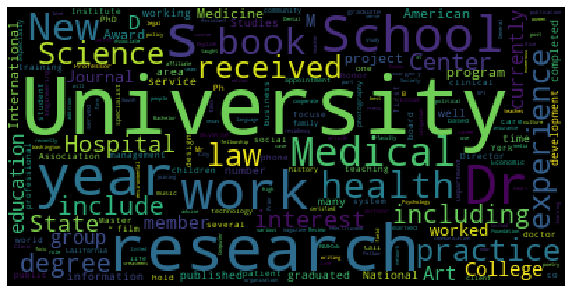

In [48]:
plt.figure(figsize=(10,10))
plt.imshow(wordcloud_word,cmap=plt.cm.Paired)
plt.axis("off")
plt.show()

In [107]:
DATA_CLEANED_PATH = DATA_PATH + '/cleaned'
ct = CleanText(stemming=True, lem=False)
ct.clean_save(train_tot, 'train_tot', "description", "description_cleaned", DATA_CLEANED_PATH)

100%|████████████████████████████████████████████████████████████████████████| 217197/217197 [02:48<00:00, 1291.36it/s]


In [108]:
train_tot_clean = pd.read_csv(os.path.join(DATA_CLEANED_PATH,'train_tot_cleaned_stem.csv'),index_col=0)

In [109]:
train_tot_clean.head(5)

,Id,description,gender,Category,Category name,description_cleaned
0,0,She is also a Ronald D. Asmus Policy Entrepre...,F,19,professor,ronald asmus polici entrepreneur fellow german...
1,2,Dr. Aster has held teaching and research posi...,M,19,professor,dr aster held teach research posit ben gurion ...
2,10,"An elder in the United Methodist Church, she ...",F,19,professor,elder unit methodist church write lectur wide ...
3,11,She has written numerous scholarly articles o...,F,19,professor,written numer scholar articl topic concern afr...
4,12,"He is an expert on black Pentecostalism, an o...",M,19,professor,expert black pentecost ordain minist church go...


In [110]:
length_descriptions_clean = (train_tot_clean.description_cleaned.map(lambda train_tot_cleaned :len(train_tot_cleaned)))
print("Plus longue description :", max(length_descriptions_clean), "mots")

Plus longue description : 755 mots


In [111]:
px.box(length_descriptions_clean)

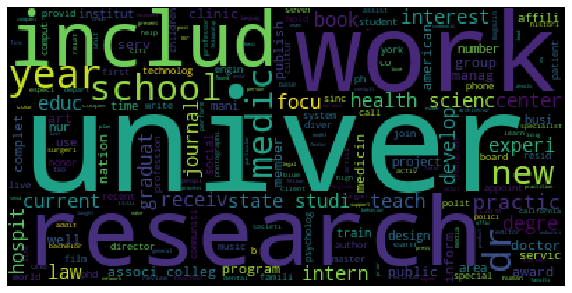

In [112]:
all_descr_clean = " ".join(train_tot_clean.description_cleaned.values)
wordcloud_word = WordCloud(background_color="black", collocations=False).generate_from_text(all_descr_clean)

plt.figure(figsize=(10,10))
plt.imshow(wordcloud_word,cmap=plt.cm.Paired)
plt.axis("off")
plt.show()

In [113]:
occurences = train_tot_clean.description_cleaned.str.split(expand=True).stack().value_counts()

In [117]:
len(occurences)

167431

In [115]:
nb = 40
px.bar(y=occurences.head(nb).values,x=occurences.head(nb).index, labels={'x': 'Words', 'y': 'Count'})

**Comment travailler avec ce problème ?**

* Au niveau du classifieur :
    * Random Forest : class_weight = balanced
    * Boosting : scale_pos_weight = ...
    
* Au niveau du dataset : dupliquer les lignes de métiers sous représenté

In [106]:
import re
import unicodedata
import nltk
from tqdm import tqdm
import os


class CleanText:
    '''
    This class is used to clean df with text description
    '''

    def __init__(self, stemming=True, lem=False):

        english_stopwords = nltk.corpus.stopwords.words('english')
        english_stopwords.append('also')

        self.stopwords = [self.remove_accent(sw) for sw in english_stopwords]

        # Args
        self.stemming = stemming
        self.lem = lem

    @staticmethod
    def convert_text_to_lower_case(txt):
        '''
        :param txt: text (str) to put in lower case
        :return: text (str) in lower
        '''
        return txt.lower()

    @staticmethod
    def remove_accent(txt):
        '''
        :param txt: text (str) to remove accent
        :return: text (str) without accent
        '''
        return unicodedata.normalize('NFD', txt).encode('ascii', 'ignore').decode("utf-8")

    @staticmethod
    def remove_non_letters(txt):
        '''
        :param txt: text (str)
        :return: only text (str) with alphabet letters
        '''
        regex_mail = '\S+@\S+'
        regex_url = r"(?i)\b((?:https?://|www\d{0,3}[.]|[a-z0-9.\-]+[.][a-z]{2,4}/)(?:[^\s()<>]+|\(([^\s()<>]+|(\([^\s()<>]+\)))*\))+(?:\(([^\s()<>]+|(\([^\s()<>]+\)))*\)|[^\s`!()\[\]{};:'\".,<>?«»“”‘’]))"
        aux1 = re.sub(regex_url, ' ', txt)
        aux2 = re.sub(regex_mail, ' ', aux1)
        return re.sub('[^a-z_]', ' ', aux2)

    def remove_stopwords(self, txt):
        '''
        :param txt: text (str)
        :return: (list of str) without stopwords
        '''
        return [w for w in txt.split() if (w not in self.stopwords)]

    @staticmethod
    def get_stem(tokens):
        '''
        :param tokens: (list of str)
        :return: (list of str) with stemmed tokens
        '''
        stemmer = nltk.stem.SnowballStemmer('english')
        return [stemmer.stem(token) for token in tokens]

    @staticmethod
    def get_lem(tokens):
        lemmatizer = nltk.stem.WordNetLemmatizer()
        return [lemmatizer.lemmatize(token) for token in tokens]

    def apply_all_transformation(self, txt):
        '''
        apply all transformation above on a text description
        :param txt: text description (str)
        :return: (list of str) cleaned
        '''
        txt = self.convert_text_to_lower_case(txt)
        txt = self.remove_accent(txt)
        txt = self.remove_non_letters(txt)
        tokens = self.remove_stopwords(txt)
        if self.stemming:
            tokens = self.get_stem(tokens)
        if self.lem:
            tokens = self.get_lem(tokens)
        return tokens

    def clean_df_column(self, df, column_name, clean_column_name):
        '''
        clean all the text lines of the df columns and add a new columns on this df that contains the cleaned line
        :param df:
        :param column_name: column name to clean (str)
        :param clean_column_name: cleaned column name (str)
        :return: df with cleaned column
        '''
        df[clean_column_name] = [" ".join(self.apply_all_transformation(x)) for x in tqdm(df[column_name].values)]

    def get_str(self):
        str_params = '_cleaned'
        if self.stemming:
            str_params += '_stem'
        elif self.lem:
            str_params += '_lem'
        return str_params

    def clean_save(self, df, df_str, column_name, clean_column_name, DATA_CLEANED_PATH):
        self.clean_df_column(df, column_name, clean_column_name)
        df.to_csv(os.path.join(DATA_CLEANED_PATH, df_str + self.get_str() + '.csv'), index=True, encoding='utf-8')
